In [1]:
#plot_shap_beeswarm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import Normalize
import matplotlib as mpl
from matplotlib.patches import Patch
from typing import Optional, Literal

#TODO: Добавить предварительное сэмплирование, если на вход подан слишком большой датасет.
def plot_shap_beeswarm(
        df: pd.DataFrame,
        feature_names: Optional[list[str]] = None,
        shap_values: object = None,
        max_features: int = 20,
        cat_feature_threshold: float = 0.01,
        figsize: tuple[int, int] = (10, 6),
        n_samples: int = 1_000,
        palette_num: str | list = "coolwarm",
        palette_cat: str | list = "tab20",
        zero_line_color: str = "red",
        title: Optional[str] = None,
        rare_policy: Literal["combine", "drop"] = "combine",
        random_state: int = 8792,
        alpha: float = 0.7,
) -> pd.DataFrame:
    """
    Строит расширенный beeswarm-график SHAP значений с поддержкой категориальных признаков,
    отображением пропусков (NaN), цветовой нормализацией и контролируемой выборкой.
    Все уникальные значения категориальных признаков становятся отдельными признаками с именем в формате
    "родитель#категория".
    Для них строятся boxplot c усами по всему диапазону (min, max).
    Для категорий родителя вводится порог частоты для определения редких категорий (cat_feature_threshold).
    Если в параметре `rare_policy`='drop', то редкие категории удаляются, если 'combine', то создается
    признак "родитель#COMBINED_RARE".
    Все признаки, полученные от одного родителя, красятся в одинаковый цвет.

    :param df: Оригинальный DataFrame с признаками.
    :param feature_names: Список признаков для отображения. Если None — используются все.
    :param shap_values: SHAP-значения, соответствующие df по размеру (может быть DataFrame или ndarray).
    :param max_features: Максимальное количество признаков (или категорий) для отображения.
    :param cat_feature_threshold: Порог для определения редких категорий (по доле).
    :param figsize: Размер графика в дюймах (ширина, высота).
    :param n_samples: Количество наблюдений для отображения (сэмплируется).
    :param palette_num: Цветовая палитра или colormap для числовых признаков.
    :param palette_cat: Цветовая палитра для категориальных признаков.
    :param zero_line_color: Цвет вертикальной линии SHAP=0.
    :param title: Заголовок графика (опционально). Если None, то не отображается.
    :param rare_policy: Политика обработки редких категорий: 'combine' — объединить, 'drop' — удалить.
    :param random_state: Начальное значение генератора случайных чисел (для воспроизводимости).
    :param alpha: Прозрачность точек и boxplot (от 0 до 1).
    :return: DataFrame, содержащий точки для построения графика (после обработки и сэмплирования).
    """

    rng = np.random.default_rng(random_state)

    # Преобразуем SHAP-массив в DataFrame (если передан np.ndarray)
    if isinstance(shap_values, np.ndarray):
        shap_df = pd.DataFrame(shap_values, index=df.index, columns=df.columns)
    else:
        shap_df = shap_values.copy()

    # Проверка на соответствие форм и корректность параметров
    if shap_df.shape != df.shape:
        raise ValueError("Shape mismatch between df and shap_values.")
    if not (0 < cat_feature_threshold < 1):
        raise ValueError("cat_feature_threshold must be between 0 and 1.")
    if rare_policy not in {"combine", "drop"}:
        raise ValueError("rare_policy must be 'combine' or 'drop'.")
    if not (0 <= alpha <= 1):
        raise ValueError("alpha must be between 0 and 1.")

    # Сужаем датафрейм до выбранных признаков
    if feature_names:
        parents = [f for f in feature_names if f in df.columns]
    else:
        parents = list(df.columns)
    df = df[parents]
    shap_df = shap_df[parents]

    # Разделяем признаки на числовые и категориальные
    num_cols = [f for f in parents if df[f].dtype.name not in {"object","category"}]
    cat_cols = [f for f in parents if f not in num_cols]

    # Расширяем категориальные признаки: делаем отдельные колонки SHAP-значений на каждую категорию
    expanded = {}
    for f in cat_cols:
        series = df[f].astype(object)
        freq = series.value_counts(dropna=False, normalize=True)
        rare = freq[freq < cat_feature_threshold].index
        proc = series.where(~series.isin(rare), "COMBINED_RARE") if rare_policy=="combine" else series[~series.isin(rare)]
        proc = proc.fillna("NaN")
        shap_col = shap_df[f]
        for cat in proc.unique():
            expanded[f"{f}#{cat}"] = shap_col.where(proc==cat)

    # Для числовых признаков просто копируем SHAP значения
    for f in num_cols:
        expanded[f] = shap_df[f]
    shap_expanded = pd.DataFrame(expanded)

    # Сортировка признаков по среднему абсолютному SHAP влиянию
    mean_abs = shap_expanded.abs().mean().sort_values(ascending=False)
    ordered = list(mean_abs.index)[:max_features]

    # Подготовка данных для отображения: выборка сэмплов и нормализация
    records = []
    norm_map = {f: df[f].rank(pct=True) for f in num_cols} # приведение к равномерному распределению. TODO: потом сделаю умнее
    for feat in ordered:
        vals = shap_expanded[feat].dropna()
        idx = rng.choice(vals.index, min(len(vals), n_samples), replace=False)
        is_cat = feat not in num_cols
        for i in idx:
            base_feat = feat.split("#", 1)[0] if is_cat else feat
            orig_val = df[base_feat].loc[i]
            norm_val = np.nan if is_cat else norm_map[feat].loc[i]
            is_nan = pd.isna(orig_val)
            records.append({
                'feature': feat,
                'shap': vals.loc[i],
                'norm_val': norm_val,
                'is_cat': is_cat,
                'is_nan': is_nan,
                'cat_value': (feat.split('#', 1)[1] if is_cat else np.nan)
            })
    plot_df = pd.DataFrame(records)
    plot_df['feature'] = pd.Categorical(plot_df['feature'], categories=ordered, ordered=True)

    # Настройка цвета: градиент для числовых, цветовая палитра для категориальных
    num_norm = Normalize(vmin=0, vmax=1)
    cmap_num = mpl.colormaps.get_cmap(palette_num) if isinstance(palette_num,str) else palette_num
    parent_cat_features = sorted({c.split('#', 1)[0] for c in ordered if '#' in c})
    cat_palette_used = sns.color_palette(palette_cat, len(parent_cat_features)) if isinstance(palette_cat,str) else palette_cat
    parent_color_map = dict(zip(parent_cat_features, cat_palette_used))

    # Построение графика
    fig = plt.figure(figsize=figsize, constrained_layout=False)
    ax = fig.add_axes([0.05,0.15,0.6,0.75])

    # Boxplot'ы для категориальных признаков
    for i, feat in enumerate(ordered):
        if feat not in num_cols:
            dfc = plot_df[plot_df.feature==feat]
            parent = feat.split('#', 1)[0]
            vals = dfc.shap.values
            bp = ax.boxplot(
                vals,
                positions=[i],
                vert=False,
                widths=0.6,
                patch_artist=True,
                whis=(0, 100),
                zorder=2
            )
            for box in bp['boxes']:
                box.set_facecolor(parent_color_map[parent])
                box.set_alpha(alpha)
            for whisker in bp['whiskers']:
                whisker.set_color(parent_color_map[parent])
            for cap in bp['caps']:
                cap.set_color(parent_color_map[parent])
            for median in bp['medians']:
                median.set_color('black')

    # Scatter точки для числовых признаков: джиттер + отдельный рендер NaN
    for i, feat in enumerate(ordered):
        if feat in num_cols:
            # Точки с известными значениями
            df_num = plot_df[(plot_df.feature == feat) & (~plot_df.is_nan)]
            if not df_num.empty:
                y_jitter = i + (rng.random(len(df_num)) - 0.5) * 0.4
                ax.scatter(
                    df_num.shap,
                    y_jitter,
                    c=[cmap_num(num_norm(v)) for v in df_num.norm_val],
                    s=20,
                    alpha=alpha,
                    linewidths=0,
                    zorder=3
                )
            # Черные точки для NaN (без джиттера)
            df_nan_num = plot_df[(plot_df.feature == feat) & (plot_df.is_nan)]
            if not df_nan_num.empty:
                ax.scatter(
                    df_nan_num.shap,
                    [i] * len(df_nan_num),
                    c='black',
                    s=20,
                    alpha=alpha,
                    linewidths=0,
                    zorder=4
                )

    # Вертикальная линия SHAP = 0
    ax.axvline(0, color=zero_line_color, linewidth=1.5, zorder=1)

    # Подписи по оси Y
    y_labels=[]
    for feat in ordered:
        if '#' in feat:
            pre,cat=feat.split('#',1)
            safe_pre=pre.replace('_', '\\_').replace(' ', '\\ ')
            safe_cat=cat.replace('_', '\\_').replace(' ', '\\ ')
            y_labels.append(r"$\mathbf{"+safe_pre+r"}\#\mathrm{"+safe_cat+r"}$")
        else:
            sf=feat.replace('_','\\_').replace(' ','\\ ')
            y_labels.append(r"$\mathbf{"+sf+r"}$")
    ax.set_yticks(range(len(ordered)))
    ax.set_yticklabels(y_labels, fontsize=10)
    ax.invert_yaxis()
    ax.set_xlabel('SHAP values')
    ax.set_ylabel('Feature')
    ax.grid(axis='x', linestyle='--', alpha=0)
    if title:
        ax.set_title(title, fontsize=14)

    # Цветовая шкала для числовых признаков
    sm=mpl.cm.ScalarMappable(cmap=cmap_num, norm=num_norm)
    sm.set_array([])
    cax=fig.add_axes([0.68,0.15,0.02,0.75])
    cbar=fig.colorbar(sm, cax=cax)

    # Легенда для категорий и NaN
    legend_elems=[Patch(facecolor='black', label='NaN')]+[Patch(facecolor=parent_color_map[p], label=p) for p in parent_cat_features]
    fig.legend(
        handles=legend_elems,
        title='Categories',
        bbox_to_anchor=(0.75,0.5),
        loc='center left',
        frameon=False
    )

    return plot_df


In [2]:
def custom_epsilon_loss_grad_hess(y_raw, tr_data=None, y_true=None, alpha=1.2, beta=0.9, epsilon=1, p=2):
    """
    Улучшенная версия epsilon-insensitive asymmetric loss с диагностикой.
    """
    # Получаем истинные значения
    if y_true is None:
        y_true = tr_data.get_label()
    
    # Проверка размерностей
    assert len(y_raw) == len(y_true), f"Размеры не совпадают: y_raw {len(y_raw)}, y_true {len(y_true)}"
    
    residuals = y_raw - y_true
    
    # Диагностика: выводим статистику по остаткам
    #print("\nДиагностика лосса:")
    #print(f"Сырые предсказания: min={np.min(y_raw):.2f}, max={np.max(y_raw):.2f}")
    #print(f"Истинные значения: min={np.min(y_true):.2f}, max={np.max(y_true):.2f}")
    #print(f"Остатки: min={np.min(residuals):.2f}, max={np.max(residuals):.2f}")
    
    # Инициализация градиента и гессиана
    grad = np.zeros_like(residuals)
    hess = np.zeros_like(residuals)
    
    # Маски для разных случаев
    within_epsilon = np.abs(residuals) <= epsilon
    overestimation = residuals > epsilon
    underestimation = residuals < -epsilon
    
    #print(f"Точек в epsilon: {np.sum(within_epsilon)}")
    #print(f"Переоценок: {np.sum(overestimation)}")
    #print(f"Недооценок: {np.sum(underestimation)}")
    
    # Вычисление градиента
    grad[overestimation] = alpha * p * (residuals[overestimation] - epsilon)**(p-1)
    grad[underestimation] = -beta * p * (-residuals[underestimation] - epsilon)**(p-1)
    
    # Вычисление гессиана
    if p > 1:
        hess[overestimation] = alpha * p * (p-1) * (residuals[overestimation] - epsilon)**(p-2)
        hess[underestimation] = beta * p * (p-1) * (-residuals[underestimation] - epsilon)**(p-2)
    
    # Защита от численной нестабильности
    grad = np.nan_to_num(grad, nan=0.0, posinf=0.0, neginf=0.0)
    hess = np.nan_to_num(hess, nan=0.0, posinf=0.0, neginf=0.0)
    
    #print(f"Градиент: min={np.min(grad):.2f}, max={np.max(grad):.2f}")
    #print(f"Гессиан: min={np.min(hess):.2f}, max={np.max(hess):.2f}")
    
    return grad, hess

In [3]:
from sklearn.neighbors import NearestNeighbors
import pandas as pd
import numpy as np

def add_knn_features(
    dataset: pd.DataFrame,
    features_for_knn: list,
    n_neighbors: int = 5,
    add_distance_stats: bool = True,
    add_neighbor_stats: bool = True
) -> pd.DataFrame:
    """
    Добавляет KNN-признаки в датасет на основе указанных признаков.
    
    Параметры:
    ----------
    dataset : pd.DataFrame
        Исходный датасет
    features_for_knn : list
        Список признаков, по которым искать соседей
    n_neighbors : int, optional
        Количество соседей для KNN (по умолчанию 5)
    add_distance_stats : bool, optional
        Добавлять статистики по расстояниям (по умолчанию True)
    add_neighbor_stats : bool, optional
        Добавлять статистики по значениям соседей (по умолчанию True)
        
    Возвращает:
    -----------
    pd.DataFrame
        Датосет с добавленными KNN-признаками
    """
    df = dataset.copy()
    X = df[features_for_knn].values
    
    # Инициализация и обучение модели KNN
    knn = NearestNeighbors(n_neighbors=n_neighbors+1, metric='euclidean')  # +1 чтобы исключить сам объект
    knn.fit(X)
    
    # Находим расстояния и индексы соседей
    distances, indices = knn.kneighbors(X)
    
    # Исключаем сам объект (первый сосед - это сам объект)
    distances = distances[:, 1:]
    indices = indices[:, 1:]
    
    # Префикс для новых признаков
    prefix = f'knn_k{n_neighbors}_'
    
    if add_distance_stats:
        # Добавляем статистики по расстояниям
        df[prefix + 'dist_mean'] = distances.mean(axis=1)
        df[prefix + 'dist_std'] = distances.std(axis=1)
        df[prefix + 'dist_min'] = distances.min(axis=1)
        df[prefix + 'dist_max'] = distances.max(axis=1)
        df[prefix + 'dist_median'] = np.median(distances, axis=1)
    
    if add_neighbor_stats:
        # Добавляем статистики по значениям соседей для каждого исходного признака
        for feature in features_for_knn:
            neighbor_values = df[feature].values[indices]
            
            df[prefix + f'{feature}_mean'] = neighbor_values.mean(axis=1)
            df[prefix + f'{feature}_std'] = neighbor_values.std(axis=1)
            df[prefix + f'{feature}_min'] = neighbor_values.min(axis=1)
            df[prefix + f'{feature}_max'] = neighbor_values.max(axis=1)
            df[prefix + f'{feature}_median'] = np.median(neighbor_values, axis=1)
    
    return df

In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
from sklearn.model_selection import KFold
from sklearn.preprocessing import TargetEncoder
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import lightgbm as lgb
import seaborn as sns
from sklearn.metrics import mean_squared_error
from functools import partial

import warnings
warnings.filterwarnings('ignore', category=pd.errors.SettingWithCopyWarning)

# Загрузка данных
train = pd.read_csv('train_contest.csv')
test = pd.read_csv('test_contest.csv')
features = list(train.drop('target', axis=1).columns)

# Преобразование категориальных признаков
cat_features = train.select_dtypes(include=['object', 'category']).columns.tolist()

for feat in cat_features:
    train[feat] = train[feat].astype('category')
    test[feat] = test[feat].astype('category')

In [ ]:
train = add_knn_features(train, ['cont2', 'cont7', 'cont14'])
test = add_knn_features(test, ['cont2', 'cont7', 'cont14'])

features = list(train.drop('target', axis=1).columns)

In [ ]:
%%time

params = {
    'objective': partial(custom_epsilon_loss_grad_hess,
                       alpha=1.4,     # штраф за переоценку
                       beta=1.55,      # УВЕЛИЧЕННЫЙ штраф за недооценку
                       epsilon=25,
                       p=1.83          # Более близко к L2
    ),
	#'objective': 'regression',
    'num_leaves': 159,
    'learning_rate': 0.0737060091132004,
    'feature_fraction': 0.46431757670765933,
    'bagging_fraction': 0.9634277318071895,
    'bagging_freq': 3,
    'min_child_samples': 65,
    'lambda_l1': 7.22224365354267e-07,
    'lambda_l2': 7.688630386659973e-06,
    'metric': 'rmse',
    'verbose': -1
}

n_folds = 5
kf = KFold(n_splits=n_folds, shuffle=True, random_state=42)
oof_predictions = np.zeros(len(train))
models = []

# Кросс-валидация
for fold, (train_idx, val_idx) in enumerate(kf.split(train)):
    print(f"Fold {fold + 1}/{n_folds}")
    
    # Разделение данных
    X_train, X_val = train.iloc[train_idx][features], train.iloc[val_idx][features]
    y_train, y_val = train.iloc[train_idx]['target'], train.iloc[val_idx]['target']
    
    # Создание Dataset для LightGBM
    train_set = lgb.Dataset(X_train, label=y_train, categorical_feature=cat_features)
    val_set = lgb.Dataset(X_val, label=y_val, categorical_feature=cat_features, reference=train_set)
    
    # Обучение модели
    model = lgb.train(
        params=params,
        train_set=train_set,
        valid_sets=[train_set, val_set],
        num_boost_round=1000,
        callbacks=[lgb.early_stopping(stopping_rounds=50, verbose=False)]
    )
    
    # Сохранение модели и предсказаний
    models.append(model)
    oof_predictions[val_idx] = model.predict(X_val)
    
    # Оценка качества на валидационной выборке
    fold_rmse = np.sqrt(mean_squared_error(y_val, oof_predictions[val_idx]))
    print(f"Fold {fold + 1} RMSE: {fold_rmse:.4f}\n")

# Общая оценка OOF (Out-of-Fold)
total_rmse = np.sqrt(mean_squared_error(train['target'], oof_predictions))
print(f"Overall OOF RMSE: {total_rmse:.4f}")

# Преобразование категориальных признаков в тестовом наборе
for feat in cat_features:
    test[feat] = test[feat].astype('category')

# Предсказание на тестовом наборе (усреднение предсказаний всех моделей)
test_predictions = np.zeros(len(test))
for model in models:
    test_predictions += model.predict(test[features])
test_predictions /= n_folds

test['target'] = test_predictions
test[['index', 'target']].to_csv('lgb_cv_after_opt_custom_loss.csv', index=False)

Fold 1/5
Fold 1 RMSE: 1868.0021

Fold 2/5
Fold 2 RMSE: 1872.4452

Fold 3/5
Fold 3 RMSE: 1924.1683

Fold 4/5
Fold 4 RMSE: 1832.1624

Fold 5/5
Fold 5 RMSE: 1952.0352

Overall OOF RMSE: 1890.2464
CPU times: total: 3min 46s
Wall time: 20 s


Fold 1/5
Fold 1 RMSE: 1873.7446

Fold 2/5
Fold 2 RMSE: 1873.1583

Fold 3/5
Fold 3 RMSE: 1937.8842

Fold 4/5
Fold 4 RMSE: 1844.1885

Fold 5/5
Fold 5 RMSE: 1948.7900

Overall OOF RMSE: 1895.9874
CPU times: total: 2min 13s
Wall time: 13.5 s

C:\Users\Admin\AppData\Local\Temp\ipykernel_23240\2314871822.py:12: FutureWarning: The default value of observed=False is deprecated and will change to observed=True in a future version of pandas. Specify observed=False to silence this warning and retain the current behavior
  t_prep = t_prep.pivot_table(values='cnt', columns='node_depth', index='split_feature')


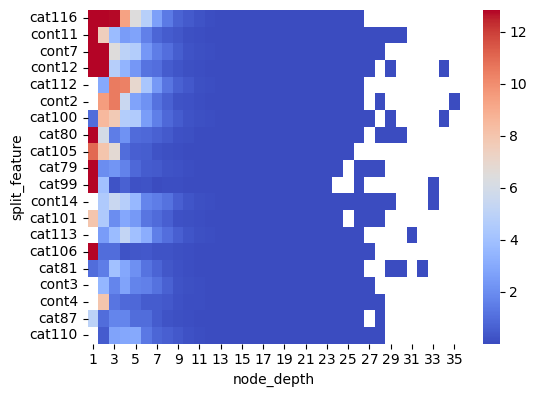

In [ ]:
def plot_feature_depth(t, top_k=20):
    t_prep = t.copy()
    t_prep.split_feature = t_prep.split_feature.astype('category')
    t_prep = (
        t_prep.query('~split_feature.isnull()')
        .groupby(['node_depth', 'split_feature'], observed=True)
        .size()
        .to_frame('cnt')
        .reset_index()
    )
    t_prep.cnt = t_prep.cnt / 2**(t_prep.node_depth - 1)
    t_prep = t_prep.pivot_table(values='cnt', columns='node_depth', index='split_feature')
    median_cnt = t_prep.sum(axis=1)
    idx = np.argsort(median_cnt)[::-1][:top_k]
    
    sns.heatmap(t_prep.iloc[idx], cmap='coolwarm', annot=False, robust=True)
    plt.gcf().set_size_inches(6, top_k/6 + 1)

t = model.trees_to_dataframe()  
plot_feature_depth(t)

In [ ]:
ы

NameError: name 'ы' is not defined

In [ ]:
df = train[features]

shap_values = model.predict(df, pred_contrib=True)


In [ ]:
shap_values = shap_values[:, :-1]

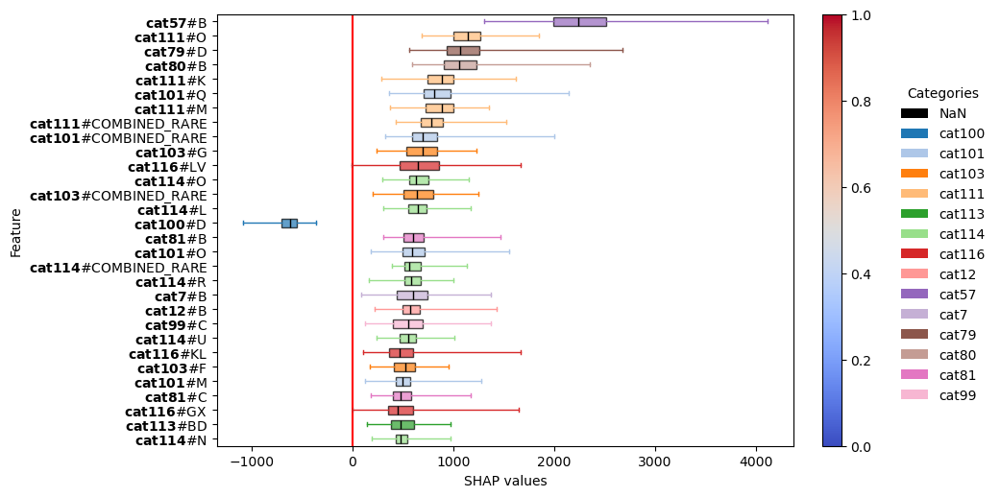

In [ ]:
aaaaaaaa = plot_shap_beeswarm(df, features, shap_values=shap_values, max_features=30, cat_feature_threshold=0.001, figsize=(10, 6), n_samples=1000)

In [ ]:
ы

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import LabelEncoder
import umap.umap_ as umap

def add_umap_features(df, n_neighbors=30, random_state=None):
    """
    Добавляет UMAP-признаки с предварительным кодированием категориальных переменных
    
    Параметры:
    df : DataFrame
        Исходный датасет
    n_neighbors : int, default=30
        Количество соседей для UMAP
    random_state : int, default=None
        Фиксация случайных состояний
    
    Возвращает:
    DataFrame
        Датасет с добавленными UMAP1 и UMAP2
    """
    # Создаем копию данных
    df = df.copy()
    
    # Разделяем на числовые и категориальные признаки
    numeric_cols = df.select_dtypes(include='number').columns
    categ_cols = df.select_dtypes(exclude='number').columns
    
    # Копируем числовые признаки
    processed_df = df[numeric_cols].copy()
    
    # Применяем Label Encoding к категориальным признакам
    for col in categ_cols:
        le = LabelEncoder()
        processed_df[col] = le.fit_transform(df[col].astype(str))
    print('лейбл готов')
    
    # Проверка наличия признаков
    if processed_df.shape[1] == 0:
        raise ValueError("Нет признаков для обработки после кодирования")
    
    # Создаем и обучаем UMAP
    reducer = umap.UMAP(
        n_neighbors=n_neighbors,
        n_components=2,
        random_state=random_state
    )
    print('юмап начался')
    
    # Применяем преобразование
    umap_embedding = reducer.fit_transform(processed_df)
    
    print('юмап готов')
    
    # Добавляем новые признаки
    df['UMAP1'] = umap_embedding[:, 0]
    df['UMAP2'] = umap_embedding[:, 1]
    
    return df

In [23]:
def add_umap_clusters(train_df, test_df, n_components=2, n_clusters=5, random_state=42):
    """
    Добавляет UMAP проекцию и кластеры в train и test датасеты
    
    Параметры:
    ----------
    train_df : pandas.DataFrame
        Тренировочный датасет
    test_df : pandas.DataFrame
        Тестовый датасет
    n_components : int, optional (default=2)
        Число компонент для UMAP
    n_clusters : int, optional (default=5)
        Число кластеров для KMeans
    random_state : int, optional (default=42)
        Seed для воспроизводимости
        
    Возвращает:
    -----------
    tuple of (train_df, test_df, umap_model, kmeans_model)
        train_df и test_df с добавленными колонками UMAP и кластерами
        umap_model и kmeans_model для возможного применения к новым данным
    """
    
    # Создаем копии, чтобы не изменять исходные датафреймы
    train = train_df.copy()
    test = test_df.copy()
    
    # Добавляем индикаторные столбцы
    train['is_train'] = 1
    test['is_train'] = 0
    
    # Объединяем данные для согласованного масштабирования и UMAP
    combined = pd.concat([train, test], axis=0)
    
    # Создаем копию для масштабированных данных
    combined_scaled = combined.copy()
    
    # Обрабатываем категориальные признаки
    categ_cols = combined.select_dtypes(exclude='number').columns.drop('is_train', errors='ignore')
    for col in categ_cols:
        le = LabelEncoder()
        combined_scaled[col] = le.fit_transform(combined[col].astype(str))
    
    # Масштабируем числовые данные (исключая is_train и закодированные категориальные)
    numeric_cols = combined.select_dtypes(include=[np.number]).columns.drop('is_train', errors='ignore')
    scaler = StandardScaler()
    
    # Заполняем пропуски перед масштабированием
    for col in numeric_cols:
        if combined_scaled[col].isna().any():
            median_val = combined_scaled[col].median()
            combined_scaled[col] = combined_scaled[col].fillna(median_val)
    
    # Масштабируем числовые признаки
    combined_scaled[numeric_cols] = scaler.fit_transform(combined_scaled[numeric_cols])
    
    # Все признаки для UMAP (числовые + закодированные категориальные)
    features_for_umap = numeric_cols.union(categ_cols)
    
    # Проверяем на наличие пропусков перед UMAP
    if combined_scaled[features_for_umap].isna().any().any():
        raise ValueError("В данных остались пропущенные значения после обработки")
    
    # Применяем UMAP
    umap_model = umap.UMAP(n_components=n_components, random_state=random_state)
    umap_features = umap_model.fit_transform(combined_scaled[features_for_umap])
    
    # Кластеризуем с помощью KMeans
    kmeans = KMeans(n_clusters=n_clusters, random_state=random_state)
    clusters = kmeans.fit_predict(umap_features)
    
    # Добавляем UMAP компоненты и кластеры в объединенный датафрейм
    for i in range(n_components):
        combined[f'umap_{i+1}'] = umap_features[:, i]
    combined['cluster'] = clusters
    
    # Разделяем обратно на train и test
    train_with_clusters = combined[combined['is_train'] == 1].drop('is_train', axis=1)
    test_with_clusters = combined[combined['is_train'] == 0].drop('is_train', axis=1)
    
    # Визуализация
    if n_components >= 2:
        plot_df = pd.DataFrame({
            'umap_1': umap_features[:, 0],
            'umap_2': umap_features[:, 1],
            'cluster': clusters,
            'dataset': ['train']*len(train) + ['test']*len(test)
        })
        
        fig = px.scatter(plot_df, x='umap_1', y='umap_2', color='cluster',
                         symbol='dataset', title='UMAP Projection with Clusters',
                         hover_data={'umap_1': ':.2f', 'umap_2': ':.2f', 'cluster': True, 'dataset': True})
        fig.show()
    
    return train_with_clusters, test_with_clusters

c:\Users\Admin\anaconda3\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning: 'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.
  warnings.warn(
c:\Users\Admin\anaconda3\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
c:\Users\Admin\anaconda3\Lib\site-packages\sklearn\manifold\_spectral_embedding.py:329: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[117]	training's rmse: 1568.06	valid_1's rmse: 1879.14
Validation RMSE: 1879.1389
shap


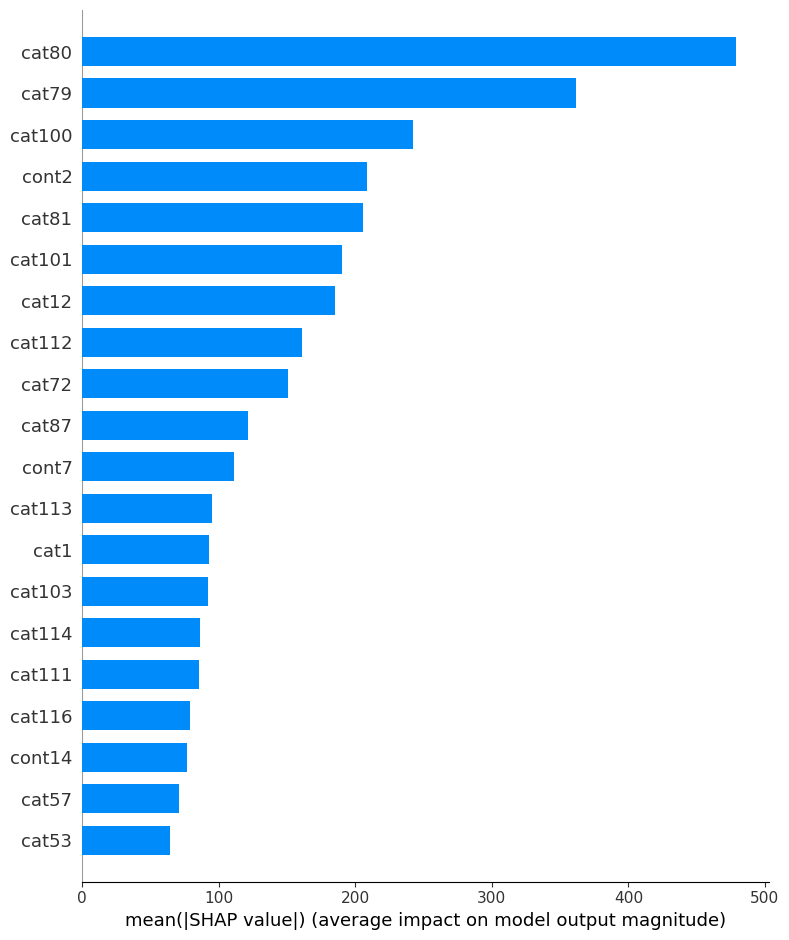

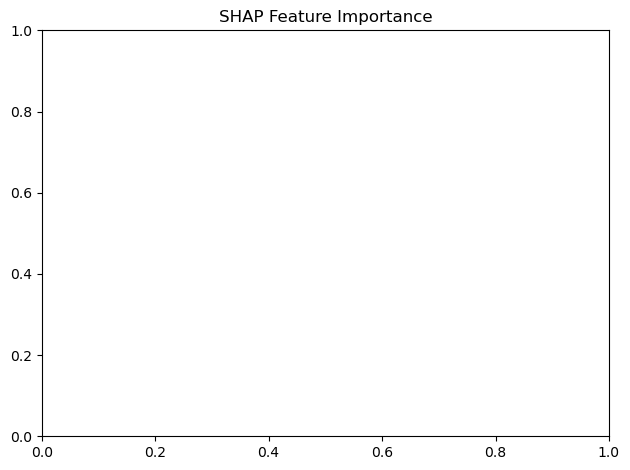

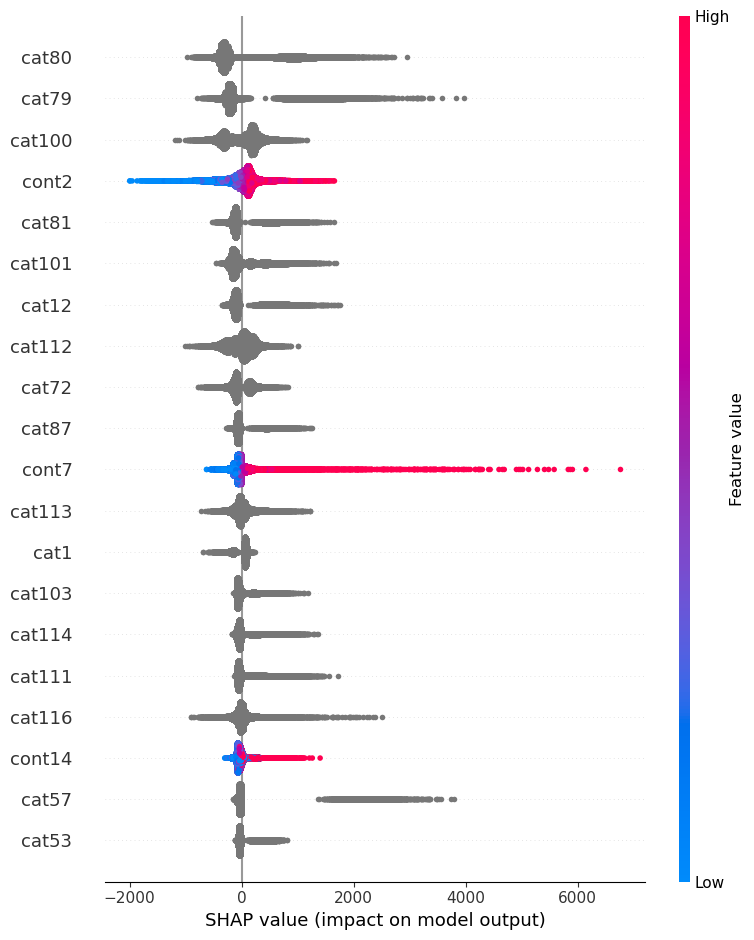

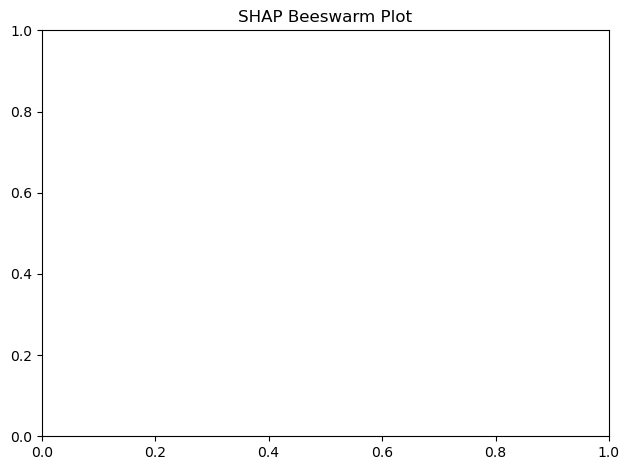

In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import lightgbm as lgb
import seaborn as sns
from sklearn.metrics import mean_squared_error
from functools import partial
import shap

import warnings
warnings.filterwarnings('ignore', category=pd.errors.SettingWithCopyWarning)

# Загрузка данных
train = pd.read_csv('train_contest.csv')
test = pd.read_csv('test_contest.csv')
features = list(train.drop('target', axis=1).columns)

# Преобразование категориальных признаков
cat_features = train.select_dtypes(include=['object', 'category']).columns.tolist()

target = train.target
train = train.drop(columns=['target'])

train, test = add_umap_clusters(train, test)

train['target'] = target


#train = add_knn_features(train, ['cont2', 'cont7', 'cont14'], 5)
#test = add_knn_features(test, ['cont2', 'cont7', 'cont14'], 5)

features = list(train.drop('target', axis=1).columns)

for feat in cat_features:
    train[feat] = train[feat].astype('category')
    test[feat] = test[feat].astype('category')

params = {
    'objective': 'regression',
    'num_leaves': 159,
    'learning_rate': 0.0737060091132004,
    'feature_fraction': 0.46431757670765933,
    'bagging_fraction': 0.9634277318071895,
    'bagging_freq': 3,
    'min_child_samples': 65,
    'lambda_l1': 7.22224365354267e-07,
    'lambda_l2': 7.688630386659973e-06,
    'metric': 'rmse',
    'verbose': -1
}

# Разделение данных на train и validation
X_train, X_val, y_train, y_val = train_test_split(
    train[features], train['target'], test_size=0.2, random_state=42
)

# Создание Dataset для LightGBM
train_set = lgb.Dataset(X_train, label=y_train, categorical_feature=cat_features)
val_set = lgb.Dataset(X_val, label=y_val, categorical_feature=cat_features, reference=train_set)

# Обучение модели
model = lgb.train(
    params=params,
    train_set=train_set,
    valid_sets=[train_set, val_set],
    num_boost_round=1000,
    callbacks=[lgb.early_stopping(stopping_rounds=50, verbose=True)]
)

# Предсказание на валидационной выборке
val_predictions = model.predict(X_val)
val_rmse = np.sqrt(mean_squared_error(y_val, val_predictions))
print(f"Validation RMSE: {val_rmse:.4f}")

# Преобразование категориальных признаков в тестовом наборе
for feat in cat_features:
    test[feat] = test[feat].astype('category')

# Предсказание на тестовом наборе
test_predictions = model.predict(test[features])
test['target'] = test_predictions


print('shap')
# SHAP анализ
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_train)

# Beeswarm plot
plt.figure(figsize=(10, 8))
shap.summary_plot(shap_values, X_train, plot_type="bar")
plt.title("SHAP Feature Importance")
plt.tight_layout()
plt.show()

plt.figure(figsize=(10, 8))
shap.summary_plot(shap_values, X_train, plot_type="dot")
plt.title("SHAP Beeswarm Plot")
plt.tight_layout()
plt.show()

In [8]:
test[['index', 'target']].to_csv('UMAP.csv', index=False)

(array([2.000e+00, 1.100e+01, 3.800e+01, 1.890e+02, 1.297e+03, 3.162e+03,
        5.006e+03, 5.296e+03, 5.144e+03, 3.407e+03, 3.456e+03, 2.423e+03,
        1.356e+03, 1.342e+03, 9.840e+02, 1.511e+03, 2.260e+03, 1.621e+03,
        1.332e+03, 1.110e+03, 8.200e+02, 7.100e+02, 7.990e+02, 8.140e+02,
        7.240e+02, 6.420e+02, 6.140e+02, 4.660e+02, 3.540e+02, 2.820e+02,
        2.640e+02, 2.860e+02, 1.840e+02, 2.500e+02, 2.620e+02, 2.310e+02,
        1.310e+02, 1.160e+02, 2.350e+02, 3.590e+02, 3.350e+02, 3.870e+02,
        4.190e+02, 5.390e+02, 3.560e+02, 1.260e+02, 3.900e+01, 3.400e+01,
        9.000e+00, 9.000e+00, 9.000e+00, 3.000e+00, 1.000e+00, 3.000e+00,
        2.000e+00, 2.000e+00, 0.000e+00, 1.000e+00, 1.000e+00, 1.000e+00,
        1.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 0.000e+00, 0.000e+0

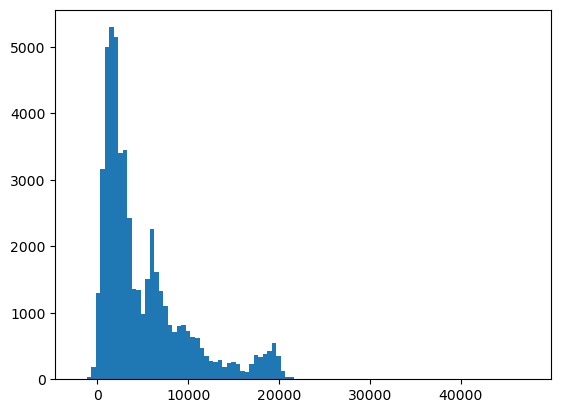

In [6]:
plt.hist(test['target'], bins=100)